# Final Proyect: Bank Marketing Segmentation

Group Members: 
- Paola Barrea
- Nicolás Bierti del Rey


The increasing number of marketing campaigns over time has reduced their effect on the general public.
In addition, economic pressures and competition have led companies to invest in targeted campaigns with strict selection of contacts. This type of campaign can be improved by using Business Intelligence (BI) and Data Mining (DM) techniques.<br><br>
The data was collected from a Portuguese marketing campaign related to the subscription of bank deposits. 
The business objective is **to find a model that can explain the success of a contact, that is, if the customer signs the deposit**.<br><br>
Such model can increase campaign efficiency by identifying the main characteristics that affect success, helping in a better management of the available resources (e.g. human effort, phone calls, time) and selection of a high quality and affordable set of potential buying customers.<br><br>
The dataset was obtained in Kaggle: https://www.kaggle.com/dhirajnirne/bank-marketing

Our problem Confussion Matrix can be explained in the following way:

- there're clients which are going to be contact because the model has predicted that they would accept and in reality they do not acquiere the service (False Positive [FP], False Positives).
- there're clients which are going to be contact because the model has predicted that they would not accept but in reality they would acquiere the service (False Negative [FN], False Negatives).
- there're clients which are going to be contact because the model has predicted that they would accept and in fact they do acquiere the service(True Positive [TP], True Positives).
- there're clients which are going to be contact because the model has predicted that they would not accept the offer and in reality they do not accept it (True Negative [TN], True Negatives).

## Data Acquisition

### Importing libraries

In [225]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import roc_auc_score,accuracy_score,recall_score
from sklearn.metrics import roc_curve
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import StratifiedKFold
from sklearn.ensemble import RandomForestClassifier
import warnings
warnings.filterwarnings('ignore')
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import PolynomialFeatures
import sklearn.metrics as skm
from sklearn.metrics import plot_roc_curve
from xgboost import XGBClassifier
from imblearn.over_sampling import SMOTE
from collections import Counter
from sklearn.datasets import make_classification
from imblearn.under_sampling import RandomUnderSampler 
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import RepeatedStratifiedKFold

In [99]:
import phik

### Importing csv files

#### Dicctionary: bank_marketing_data.csv

<span style='color:orange'>**Personal information**<br></span>
**age**<br>
**age group**<br>
**eligible:** variable base in personal information<br>
**job:** type of job <br>
**salary**<br>
**marital**<br>
**education:** level of education completed <br>
**marital-education:** combination of previous columns<br>
**targeted:** variable base in personal information. Rename: **tag**<br>
<span style='color:orange'>**Financial information**<br></span>
**default:** has unpayed credit? <br>
**balance:** remaining balance in the account <br>
**housing:** has housing loan? <br>
**loan:** has previous loan?<br>
<span style='color:orange'>**Last contact information**<br></span>
**contact:** communication type <br>
**day:** day of the month <br>
**month** <br>
**duration:** in seconds, if equal to 0 target will be 'False' <br>
**campaign:** number of contacts preformed in this campaign for this client <br>
<span style='color:orange'>**Previous campaing info**<br></span>
**pdays:** number of days pass since last contact in previous campaing, 999 equals 'no contact'. Rename: **pcampign**<br>
**previous:**  number of contacts preformed in previous campaing for this client <br>
**poutcome:** outcome of the previous marketing campaign<br>
<span style='color:orange'>**Target**<br></span>
**y:** has the client subscribed?, equal to 'response'<br>
**response** rename **outcome**

In [100]:
bank_df = pd.read_csv("bank_marketing_data.csv")
bank_df.head()

,age,age group,eligible,job,salary,marital,education,marital-education,targeted,default,...,contact,day,month,duration,campaign,pdays,previous,poutcome,y,response
0,58,5,Y,management,100000,married,tertiary,married-tertiary,yes,no,...,unknown,5,may,261,1,-1,0,unknown,no,0
1,44,4,Y,technician,60000,single,secondary,single-secondary,yes,no,...,unknown,5,may,151,1,-1,0,unknown,no,0
2,33,3,Y,entrepreneur,120000,married,secondary,married-secondary,yes,no,...,unknown,5,may,76,1,-1,0,unknown,no,0
3,47,4,Y,blue-collar,20000,married,unknown,married-unknown,no,no,...,unknown,5,may,92,1,-1,0,unknown,no,0
4,33,3,Y,unknown,0,single,unknown,single-unknown,no,no,...,unknown,5,may,198,1,-1,0,unknown,no,0


In [101]:
bank_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45211 entries, 0 to 45210
Data columns (total 23 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   age                45211 non-null  int64 
 1   age group          45211 non-null  int64 
 2   eligible           45211 non-null  object
 3   job                45211 non-null  object
 4   salary             45211 non-null  int64 
 5   marital            45211 non-null  object
 6   education          45211 non-null  object
 7   marital-education  45211 non-null  object
 8   targeted           45211 non-null  object
 9   default            45211 non-null  object
 10  balance            45211 non-null  int64 
 11  housing            45211 non-null  object
 12  loan               45211 non-null  object
 13  contact            45211 non-null  object
 14  day                45211 non-null  int64 
 15  month              45211 non-null  object
 16  duration           45211 non-null  int64

Observations:
- The variables are numeric integer & categorical.
- There's columns with binary values.
- None null values

### Renaming columns

In [102]:
bank_df.rename(columns={'age group':'age_group','targeted':'tag','previous':'pcampaign','response':'outcome'},inplace=True)
bank_df.head()

,age,age_group,eligible,job,salary,marital,education,marital-education,tag,default,...,contact,day,month,duration,campaign,pdays,pcampaign,poutcome,y,outcome
0,58,5,Y,management,100000,married,tertiary,married-tertiary,yes,no,...,unknown,5,may,261,1,-1,0,unknown,no,0
1,44,4,Y,technician,60000,single,secondary,single-secondary,yes,no,...,unknown,5,may,151,1,-1,0,unknown,no,0
2,33,3,Y,entrepreneur,120000,married,secondary,married-secondary,yes,no,...,unknown,5,may,76,1,-1,0,unknown,no,0
3,47,4,Y,blue-collar,20000,married,unknown,married-unknown,no,no,...,unknown,5,may,92,1,-1,0,unknown,no,0
4,33,3,Y,unknown,0,single,unknown,single-unknown,no,no,...,unknown,5,may,198,1,-1,0,unknown,no,0


### Droping duplicates

In [103]:
bank_df.drop_duplicates(inplace = True)
bank_df.shape

(45211, 23)

## One variable analysis

In [104]:
%matplotlib inline

### Binary variables analysis

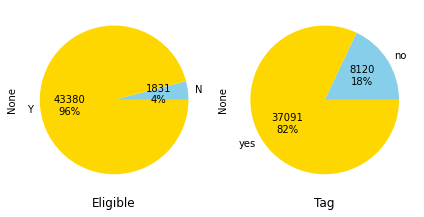

In [105]:
#Variables eligible & tag

def label_function(val):
    return f'{val / 100 * len(bank_df):.0f}\n{val:.0f}%'

fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(6, 4))

bank_df.groupby('eligible').size().plot(kind='pie', autopct=label_function, textprops={'fontsize': 10},
                                  colors=['skyblue', 'gold'], ax=ax1)
bank_df.groupby('tag').size().plot(kind='pie', autopct=label_function, textprops={'fontsize': 10},
                                 colors=['skyblue', 'gold'], ax=ax2)
                                
ax1.set_xlabel('Eligible', size=12)
ax2.set_xlabel('Tag', size=12)

plt.tight_layout()
plt.show()

Observations:
- Unbalance variables.

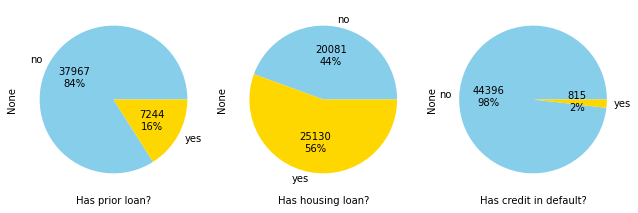

In [106]:
#Variables loan, housing & default

def label_function(val):
    return f'{val / 100 * len(bank_df):.0f}\n{val:.0f}%'

fig, (ax1, ax2,ax3) = plt.subplots(ncols=3, figsize=(9, 4))

bank_df.groupby('loan').size().plot(kind='pie', autopct=label_function, textprops={'fontsize': 10},
                                  colors=['skyblue', 'gold'], ax=ax1)
bank_df.groupby('housing').size().plot(kind='pie', autopct=label_function, textprops={'fontsize': 10},
                                 colors=['skyblue', 'gold'], ax=ax2)
bank_df.groupby('default').size().plot(kind='pie', autopct=label_function, textprops={'fontsize': 10},
                                 colors=['skyblue', 'gold'], ax=ax3)                                
ax1.set_xlabel('Has prior loan?', size=10)
ax2.set_xlabel('Has housing loan?', size=10)
ax3.set_xlabel('Has credit in default?', size=10)
plt.tight_layout()
plt.show()

Observations:
- The amount of clients with housing loan is divided almost by half.
- Most clients didn't acquired previous loans and even less are in default with their credits.


### Personal information variables

Age

In [107]:
bank_df['age'].describe()

count    45211.000000
mean     40.936210   
std      10.618762   
min      18.000000   
25%      33.000000   
50%      39.000000   
75%      48.000000   
max      95.000000   
Name: age, dtype: float64

In [108]:
px.box(bank_df, y= 'age', title = 'Age',).show()


Job

In [109]:
px.histogram(bank_df, x= bank_df['job'], labels={'x':'Job area'}, title = 'Job area count').show()

Salary

In [110]:
bank_df['salary'].describe()

count    45211.000000 
mean     57006.171065 
std      32085.718415 
min      0.000000     
25%      20000.000000 
50%      60000.000000 
75%      70000.000000 
max      120000.000000
Name: salary, dtype: float64

In [111]:
px.box(bank_df, y= 'salary', title = 'Salary').show()

Education

In [112]:
education_count = bank_df['education'].value_counts().reset_index()
education_count.rename(columns={'index':'education','education':'num_clients'}, inplace=True)
px.pie(education_count, values='num_clients' , names='education', title = 'Level of education',hole=.4).show()

Balance

In [113]:
px.box(bank_df, y= 'balance', title = 'Balance').show()

In [114]:
# Percentage of the entries that fall into outliers in the variable balance
balance_out = bank_df.loc[(bank_df['balance'] >= -2000) & (bank_df['balance'] <= 3500)].shape
perctg_outlier = (bank_df.shape[0] - balance_out[0])/bank_df.shape[0]*100
perctg_outlier


10.313861670832319

Observation:<br>
- Most of the clients fall into the **age range between 30 and 50**. There is outliers over 70.<br>
- 5 of the 12 job areas encompasses most of the clients.<br>
- There's **no outliers** in **salary**. This variable has a fairly even distribution.
- Most of the clients have reached a secondary or terciary level of education.

### Contact variables

Contact type

In [115]:
contact_count = bank_df['contact'].value_counts().reset_index()
px.pie(contact_count, values='contact' , names='index', title = 'Type of contact',hole=.4).show()

Month

In [116]:
px.histogram(bank_df, x= bank_df['month'], labels={'x':'Month'}, title = 'Number of contacts per month').show()

In [117]:
px.histogram(bank_df, x= bank_df['day'], labels={'x':'Day'}, title = 'Number of contacts per number of day in the month').show()

Duration

In [118]:
px.violin(bank_df, y='duration')

In [119]:
bank_df['duration'].describe()

count    45211.000000
mean     258.163080  
std      257.527812  
min      0.000000    
25%      103.000000  
50%      180.000000  
75%      319.000000  
max      4918.000000 
Name: duration, dtype: float64

Number of contacts in campaign

In [120]:
px.box(bank_df, y='campaign',title='Number of contacts during Campaign')

Observations:<br>
- Most contacts were made by cellphone, there's missing information reflected as 'unknown'.<br>
- Most contacts were made between may and august.<br>
- There's difference int he number of contacts according to the day, but there is no visible relation.<br>
- There is many **outliers** in the variables **duration & campaign**. Most are conentrated under 1500 seconds in duration and under 6 contacts in campaign.

### Target analysis

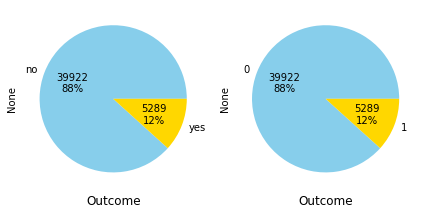

In [121]:
def label_function(val):
    return f'{val / 100 * len(bank_df):.0f}\n{val:.0f}%'

fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(6, 4))

bank_df.groupby('y').size().plot(kind='pie', autopct=label_function, textprops={'fontsize': 10},
                                  colors=['skyblue', 'gold'], ax=ax1)
bank_df.groupby('outcome').size().plot(kind='pie', autopct=label_function, textprops={'fontsize': 10},
                                 colors=['skyblue', 'gold'], ax=ax2)
                                
ax1.set_xlabel('Outcome', size=12)
ax2.set_xlabel('Outcome', size=12)

plt.tight_layout()
plt.show()

Observations:<br>
- It's highly likely that both variables are the same, this can be confirm with correlation.

## Two variables analysis

### Correlations

Text(0.5, 1.0, 'Variables correlation')

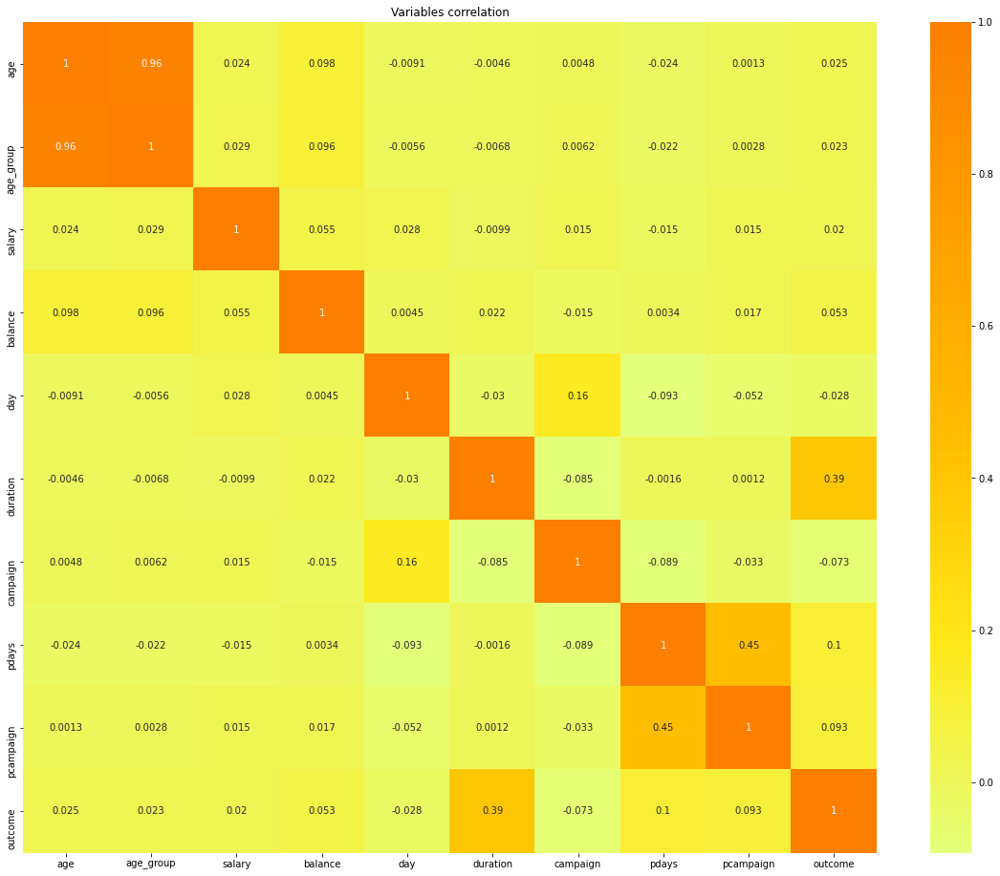

In [122]:
plt.rcParams['figure.figsize'] = (20, 16)
#Correlation for numeric variables 
sns.heatmap(bank_df.corr(), annot = True, cmap = 'Wistia')
plt.title('Variables correlation')

Observations:<br>
- High linear correlation between **duration & outcome**, target variable.<br>
- Some linear correlation between **days since last marketing campaign contact (pdays) & response**.<br>
- High linear correlation between **pdays & amount of times contacted the client in previous campaign (pcampaign)**.<br>
- Some linear correlation between **day of contact (day) & number of contacts to the client (campaign) **.<br>


interval columns not set, guessing: ['age', 'age_group', 'salary', 'balance', 'day', 'duration', 'campaign', 'pdays', 'pcampaign', 'outcome']


Text(0.5, 1.0, 'Variables correlation with phik')

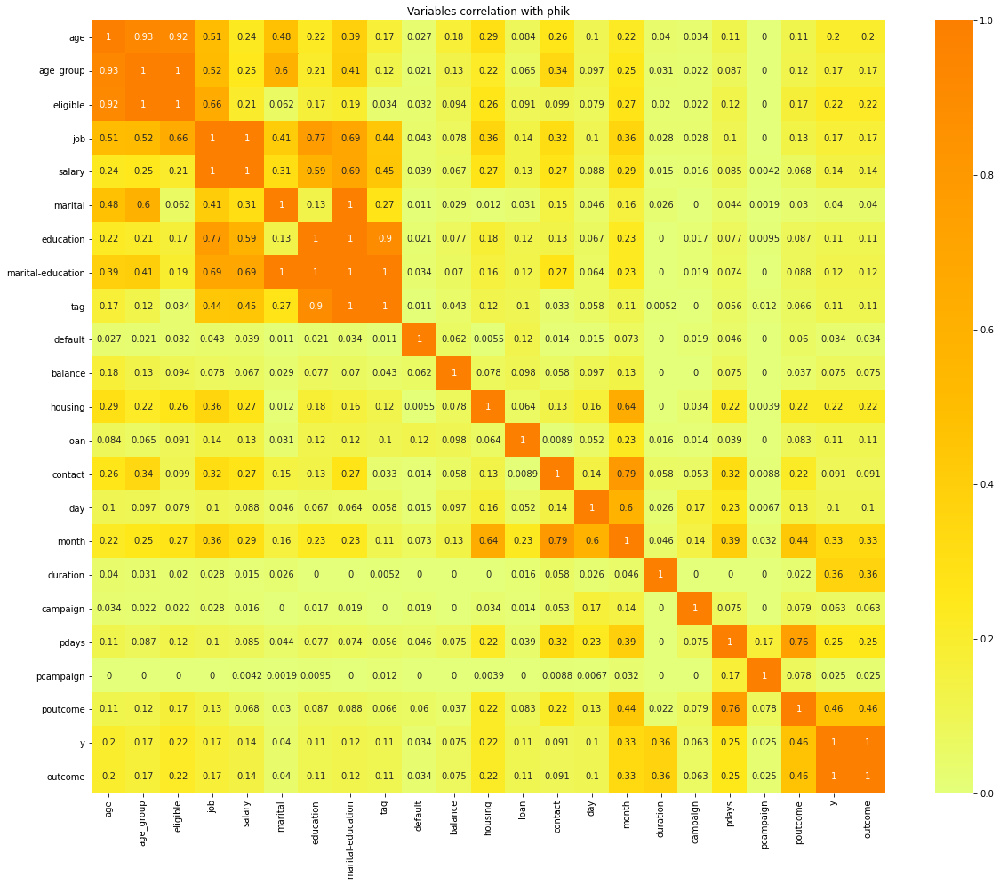

In [123]:
plt.rcParams['figure.figsize'] = (20, 16)
#It is use 'phik' correlation to be able to obtain correlation between categorical variables 
sns.heatmap(bank_df.phik_matrix(), annot = True, cmap = 'Wistia')
plt.title('Variables correlation with phik')

Observation:<br>
- The variables 'y' & 'outcome' have a correlation of **1** and the same correlation with other variables, confirming that they're the same varible, different expression.<br>
- The variable **outcome** is correlatead with the following variables, order from highest to lower:
    - **poutcome:** outcome in previous campaign.
    - **duration:** call duration in seconds.
    - **month**
    - **pdays**
    - **housing loan & eligible**
    - **age**
    - **job**
- The following variables have a high correlation between each other:
    - age, age group & eligible
    - job with the previous variables
    - **job & salary** with a correlation of **1**
    - **job, education & marital_education**
    - **education, marital_education & tag** **1 & 0.9**
    - **month & day**

### Duration vs Outcome

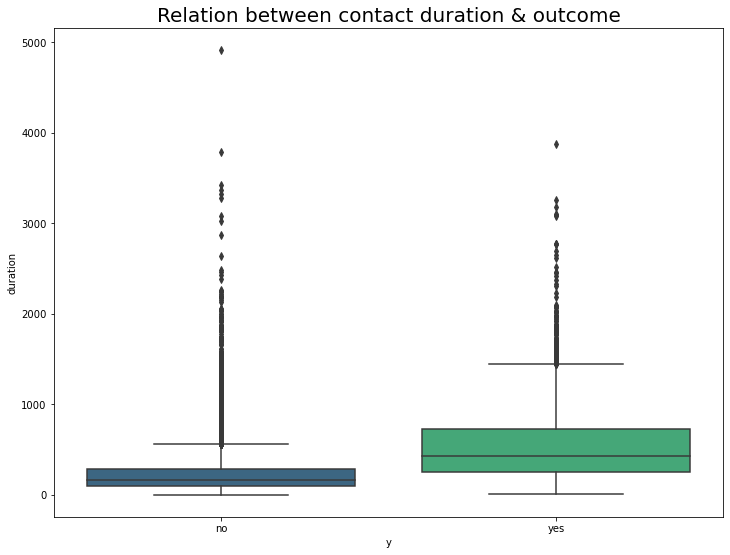

In [124]:
plt.rcParams['figure.figsize'] = (12, 9)

sns.boxplot(bank_df['y'], bank_df['duration'], palette = 'viridis')
plt.title('Relation between contact duration & outcome', fontsize = 20)
plt.show()

In [125]:
fig = px.box(bank_df, x="y", y="duration",title='Relation between contact duration & outcome')
fig.show()

Observations:<br>
- When **outcome** is **yes**, **duration** has a **higher median**.<br>
- Duration over 279 are more likely to be a **yes** response. 

### poutcome vs pdays

In [126]:
fig = px.box(bank_df, x="poutcome", y="pdays",title='Relation between days since last campign contact & previous outcome')
fig.show()

Observations:<br>
- If the number of days (pdays) is under 200, the previous outcome (poutcome) was likely successful. And, since this has a positive correlation with the current outcome, this is likely to be **yes**.

### Marital-education & tag

In [127]:
fig = px.histogram(bank_df, x="marital-education", color="tag", title="Relation between education & tag variable")
fig.show()

In [128]:
bank_df.groupby(['tag','y']).size().reset_index()

,tag,y,0
0,no,no,6785
1,no,yes,1335
2,yes,no,33137
3,yes,yes,3954


Observations:<br>
- The variable **tag** is defined base on the variable **marital-education** which in turn is a combination of those variables.<br>
- The variable **tag** does not have a visible correlation with **outcome**.

### Age group & eligible

In [129]:
fig = px.histogram(bank_df, x="age_group", color="eligible", title="Relation between age group & eligible variable")
fig.show()

Observations:<br>
- The variable **eligible** is defined base on the variable **age_group** which in turn is base on age.<br>

### Salary & job

In [130]:
bank_df.groupby(['job','salary']).size().reset_index()

,job,salary,0
0,admin.,50000,5171
1,blue-collar,20000,9732
2,entrepreneur,120000,1487
3,housemaid,16000,1240
4,management,100000,9458
5,retired,55000,2264
6,self-employed,60000,1579
7,services,70000,4154
8,student,4000,938
9,technician,60000,7597


### Month & outcome

In [131]:
fig = px.histogram(bank_df, x="month", color="y", title="Relation between month & outcome")
fig.show()

In [132]:
# Cross tabulation
month_tab = pd.crosstab(index=bank_df['month'],columns=bank_df['y']).reset_index()
perctg = [i for i in month_tab['yes']/(month_tab['yes']+month_tab['no'])*100] 
month_tab['%'] = perctg
month_tab.sort_values(by = '%')


y,month,no,yes,%
8,may,12841,925,6.719454
5,jul,6268,627,9.093546
4,jan,1261,142,10.121169
9,nov,3567,403,10.151134
6,jun,4795,546,10.222805
1,aug,5559,688,11.013286
3,feb,2208,441,16.647792
0,apr,2355,577,19.679400
10,oct,415,323,43.766938
11,sep,310,269,46.459413


Observations:<br>
The outcome percentage varies according to the contact month, but the amount of contacts per month also varies.

### Job & outcome

In [133]:
fig = px.histogram(bank_df, x="job", color="y", title="Relation between job & outcome")
fig.show()

Observations:<br>
The outcome varies slightly according to the ocupation of the client.

### Week of the month & outcome

In [134]:
# Grouping the variable day in weeks
conditions = [
    (bank_df['day'] >= 1) & (bank_df['day'] <= 7),
    (bank_df['day'] >= 8) & (bank_df['day'] <= 14),
    (bank_df['day'] >= 15) & (bank_df['day'] <= 21),
    (bank_df['day'] >= 22) & (bank_df['day'] <= 31)
]

choices = ['1','2','3','4']

bank_df['week'] = np.select(conditions, choices)


In [135]:
fig = px.histogram(bank_df, x="week", color="y", title="Relation between week & outcome")
fig.show()

In [136]:
bank_df.drop(['week'], axis =1, inplace=True)

Observation:<br>
There's no visible relation between the week of the month of contact (beggining or ending of the week) and the outcome.


## Multivariate analysis

In [137]:
#sns.pairplot(bank_df, hue='y')

General analysis, there's no visible relation between the variables.

### Loan, housing & outcome

In [138]:
fig = px.parallel_categories(bank_df, color="outcome", dimensions= ['eligible', 'housing', 'loan','y'],color_continuous_scale=px.colors.sequential.Inferno)
fig.show()

In [139]:
# Cross tabulation
loan_tab = pd.crosstab(index=bank_df['loan'],columns=bank_df['y'])
print(loan_tab)

y        no   yes
loan             
no    33162  4805
yes   6760   484 


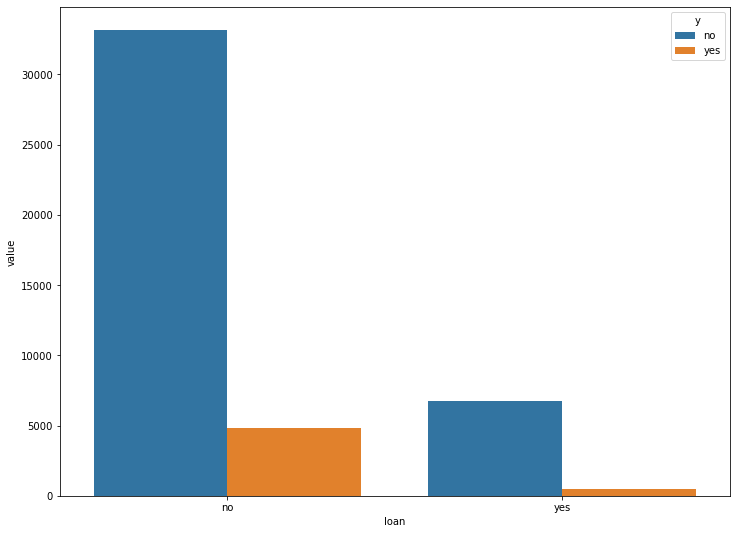

In [140]:
# Stack and reset
stacked = loan_tab.stack().reset_index().rename(columns={0:'value'})

# plot grouped bar chart
p = sns.barplot(x=stacked['loan'], y=stacked['value'], hue=stacked['y'], order=['no', 'yes'])

In [141]:
from scipy.stats import chi2_contingency

In [142]:
#If chi2 under 0.05, there is correlation between the variables. In this case, loan vs outcome
chi2_contingency(loan_tab)[1]

1.665061163492756e-47

Looking to find a relation between the variables housing, loan and outcome. There could be some relation, but is not visible or strong enough.

### Duration, age, poutcome & housing

In [143]:
fig = px.scatter(bank_df, x="duration", y="age", color="y", facet_col="poutcome",facet_row='housing')
fig.show()

The purpose of this plot is to discern, in a visual manner, if the most correlated variables can divide the outcome in groups.<br>
It looks like most 'yes' outcomes are concentrated in 'poutcome' unknown and success; 'housing' has no discernible impact.

### Balance, age, poutcome & loan

In [144]:
fig = px.scatter(bank_df, x="balance", y="age", color="y", facet_col="poutcome",facet_row='loan')
fig.show()

The purpose of this plot is to discern, in a visual manner, if the use variables can divide the outcome in groups.<br>
It looks like most 'yes' outcomes are concentrated in 'poutcome' unknown and success; 'loan' seems to concentrate more 'yes' outcome in the 'no' answer.<br>
The variable 'balance', with low correlation in the matrix, does seem to have some impact in the outcome.

## ML: Columns alternatives

### Defining alternatives: dropping columns

The following considerations are taken into account when dropping columns:<br>
- This columns are highly correlated with each other, so only one of them must remain:<br>
    - age, age_group, eligible<br>
    - job, salary<br>
    - marital, education, marital-education, tag<br>
    - pdays, pcampaign, poutcome<br>
- The variable 'day' it has a hihg cardinality and low correlation with target.
- The columns 'duration' and 'campaign' is information that we're not going to have in future predictive models,
since it's the information of the contact we haven't made yet. This column can be use for benchmarketing.

In [145]:
#Bench marketing dataframe
bank_bm = bank_df.copy()

In [146]:
#Dropping the columns that we shouldn't use in the prediction
bank_df.drop(['duration','campaign'], axis =1, inplace=True)

In [147]:
#Option 1
df1 = bank_df.drop(['age','eligible', 'salary', 'education', 'marital', 'tag', 'day', 'pdays','pcampaign', 'y'], axis =1)

In [148]:
#Option 2: Uses age instead of age_group
df2 = bank_df.drop(['age_group','eligible', 'salary', 'education', 'marital', 'tag', 'day', 'pdays','pcampaign', 'y'], axis =1)

In [149]:
#Option 3: Uses marital & education instead of marital-education
df3 = bank_df.drop(['age','eligible', 'salary', 'marital-education', 'tag', 'day', 'pdays','pcampaign', 'y'], axis =1)

In [150]:
#Option 4: Uses only marital instead of marital-education
df4 = bank_df.drop(['age','eligible', 'salary', 'marital-education', 'education', 'tag', 'day', 'pdays','pcampaign', 'y'], axis =1)

In [151]:
#Option 5: Uses salary instead of job
df5 = bank_df.drop(['age','eligible', 'job', 'education', 'marital', 'tag', 'day', 'pdays','pcampaign', 'y'], axis =1)

In [152]:
#Option 6: Without contact
df6 = bank_df.drop(['age','eligible', 'salary', 'contact','education', 'marital', 'tag', 'day', 'pdays','pcampaign', 'y'], axis =1)

## Random Forest Function

### Function

In [153]:
# def random_forest(X_train, y_train, X_test, y_test):
def random_forest(dataframe,attempt_name):
    
    dataframe_dummy = pd.get_dummies(dataframe, drop_first=True)

    #Spliting entry from target
    X = dataframe_dummy.drop('outcome', axis=1) #Target is drop from the data
    y = dataframe_dummy.outcome #Target

    #30% for test & 70% for train
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30, random_state=1, stratify= y) 

    rnd_forest = RandomForestClassifier(max_depth=4,
                                        random_state=1, 
                                        n_estimators=200,
                                        class_weight="balanced_subsample", 
                                        max_features="log2", 
                                        bootstrap=True)

    #Preprocessing
    overs = SMOTE(sampling_strategy= 0.2, random_state= 1)
    os_Xtrain,os_ytrain = overs.fit_resample(X_train,y_train)
    
    #Model Training
    rnd_forest.fit(os_Xtrain,os_ytrain)
    
    # predict probabilities
    rf_probs = rnd_forest.predict_proba(X_test)
    # keep probabilities for the positive outcome only
    rf_probs = rf_probs[:, 1]
    # calculate precision and recall for each threshold
    rf_precision, rf_recall, _ = skm.precision_recall_curve(y_test, rf_probs)
    # predict class values
    y_train_prf = rnd_forest.predict(X_train) #Test prediction
    y_test_prf = rnd_forest.predict(X_test) #Test prediction

    #METRICS 
    #Recall in Train
    train_recall = skm.recall_score(y_train, y_train_prf)

    #Recall in Test
    test_recall = skm.recall_score(y_test, y_test_prf)

    #precision in Train
    train_precision = skm.precision_score(y_train, y_train_prf)

    #precision in Test
    test_precision = skm.precision_score(y_test, y_test_prf)

    #ROC AUC in Test
    roc_auc = skm.roc_auc_score(y_test, y_test_prf)

    # PR AUC in Test
    rf_auc = skm.auc(rf_recall, rf_precision)

    fn = skm.confusion_matrix(y_test, y_test_prf)[1][0]
    fp = skm.confusion_matrix(y_test, y_test_prf)[0][1]

    results={"name": attempt_name,
            "train_recall": train_recall, 
             "test_recall":test_recall, 
             "precision": test_precision,
             "roc_auc": roc_auc,
              "pr_auc": rf_auc,
              "FN": fn,
              "FP": fp}

    #Variables importance
    plt.figure(figsize=(6,6))
    importances = rnd_forest.feature_importances_
    columns = X.columns
    sns.barplot(columns, importances)
    plt.title('Feature importance')
    plt.xticks(rotation = 90)
    plt.show()
    
    return results

### Results Table Creation (NO TOCAR, SOLO CORRER UNA VEZ)

In [154]:
# An empty df is created to store the metrics of each alternative (NO TOCAR)
column_names = ["name","train_recall", "test_recall", "precision","roc_auc","pr_auc", "FN","FP"]
rf_result_df = pd.DataFrame(columns = column_names)

### RF 1 df1

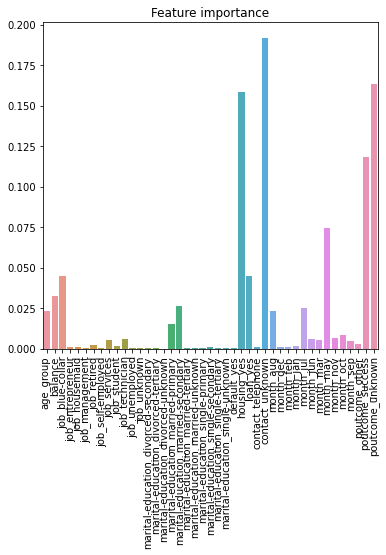

In [155]:
results_1 = random_forest(df1, 'df1');
rf_result_df = rf_result_df.append(results_1, ignore_index = True)

### RF 1 df2

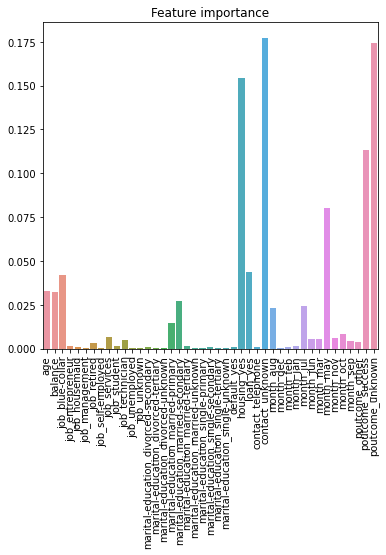

In [156]:
results_2 = random_forest(df2, 'df2');
rf_result_df = rf_result_df.append(results_2, ignore_index = True)

### RF 1 df3

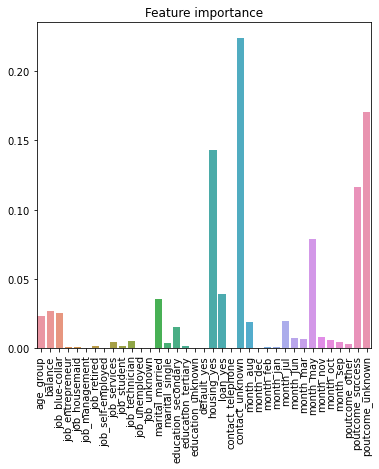

In [157]:
results_3 = random_forest(df3, 'df3');
rf_result_df = rf_result_df.append(results_3, ignore_index = True)

### RF 1 df4

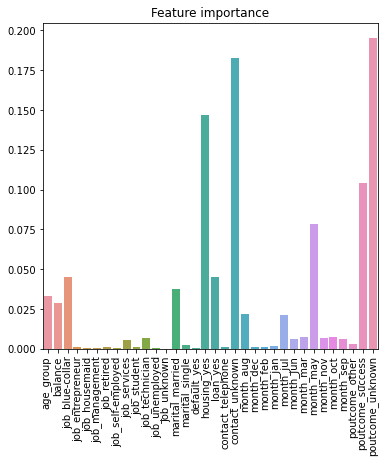

In [158]:
results_4 = random_forest(df4, 'df4');
rf_result_df = rf_result_df.append(results_4, ignore_index = True)

### RF 1 df5

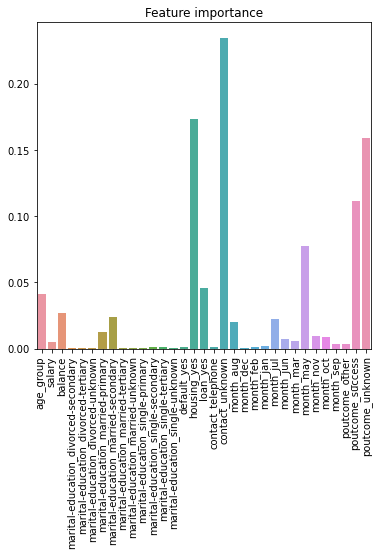

In [159]:
results_5 = random_forest(df5, 'df5');
rf_result_df = rf_result_df.append(results_5, ignore_index = True)

### RF 1 df6

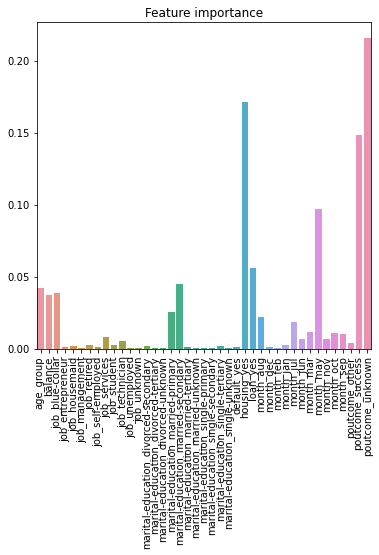

In [160]:
results_6 = random_forest(df6, 'df6');
rf_result_df = rf_result_df.append(results_6, ignore_index = True)

### Visualize Results Table

In [161]:
rf_result_df

,name,train_recall,test_recall,precision,roc_auc,pr_auc,FN,FP
0,df1,0.647488,0.654064,0.244581,0.693192,0.370697,549,3206
1,df2,0.641275,0.644612,0.248482,0.693142,0.370736,564,3094
2,df3,0.652620,0.657845,0.242960,0.693121,0.371639,543,3253
3,df4,0.620205,0.620038,0.261493,0.694005,0.368729,603,2779
4,df5,0.659643,0.661626,0.234689,0.687872,0.372399,537,3424
5,df6,0.594003,0.583491,0.256652,0.679781,0.360738,661,2682


In [162]:
# The following dataframe is the chosen to train the model
df0 = df5

In [163]:
df0_dummy = pd.get_dummies(df0, drop_first=True)

In [164]:
df0_dummy.head()

,age_group,salary,balance,outcome,marital-education_divorced-secondary,marital-education_divorced-tertiary,marital-education_divorced-unknown,marital-education_married-primary,marital-education_married-secondary,marital-education_married-tertiary,...,month_jul,month_jun,month_mar,month_may,month_nov,month_oct,month_sep,poutcome_other,poutcome_success,poutcome_unknown
0,5,100000,2143,0,0,0,0,0,0,1,...,0,0,0,1,0,0,0,0,0,1
1,4,60000,29,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,1
2,3,120000,2,0,0,0,0,0,1,0,...,0,0,0,1,0,0,0,0,0,1
3,4,20000,1506,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,1
4,3,0,1,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,1


## ML: Preprocessing alternatives

### SMOTE

In [165]:
#Spliting entry from target
X = df0_dummy.drop('outcome', axis=1) #Target is drop from the data
y = df0_dummy.outcome #Target

from sklearn.model_selection import train_test_split #Importing data to create train and test groups

#30% for test & 70% for train
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30, random_state=53, stratify= y) 

In [166]:
from sklearn.ensemble import RandomForestClassifier #Importing the model
rnd_forest = RandomForestClassifier(max_depth=4,
                                    random_state=1, 
                                    n_estimators=200,
                                    class_weight="balanced_subsample", 
                                    max_features="log2", 
                                    bootstrap=True)

In [167]:
from imblearn.over_sampling import SMOTE
import sklearn.metrics as skm

In [168]:
# An empty df is created to store the metrics of each alternative
column_names = ["Sampling", "recall", "precision","roc_auc", "FN","FP"]

pfm_smote = pd.DataFrame(columns = column_names)

In [169]:
for i in range(2,9):
    #Fitting the model
    overs = SMOTE(sampling_strategy= i*0.1, random_state= 0)
    os_Xtrain,os_ytrain = overs.fit_resample(X_train,y_train)
    rnd_forest.fit(os_Xtrain,os_ytrain)

    y_train_prf = rnd_forest.predict(X_train) #Train prediction
    y_test_prf = rnd_forest.predict(X_test) #Test prediction

    # predict probabilities
    rf_probs = rnd_forest.predict_proba(X_test)
    # keep probabilities for the positive outcome only
    rf_probs = rf_probs[:, 1]
    
    # calculate precision and recall for each threshold
    rf_precision, rf_recall, _ = skm.precision_recall_curve(y_test, rf_probs)
   
    #METRICS 

    #Recall in Train
    train_recall = skm.recall_score(y_train, y_train_prf)

    #Recall in Test
    test_recall = skm.recall_score(y_test, y_test_prf)

    #precision in Train
    train_precision = skm.precision_score(y_train, y_train_prf)

    #precision in Test
    test_precision = skm.precision_score(y_test, y_test_prf)

    #ROC AUC in Test
    roc_auc = skm.roc_auc_score(y_test, y_test_prf)

    # PR AUC in Test
    rf_auc = skm.auc(rf_recall, rf_precision)

    #Confusion matrix
    fn = skm.confusion_matrix(y_test, y_test_prf)[1][0]
    fp = skm.confusion_matrix(y_test, y_test_prf)[0][1]

    option = {"Sampling": i*0.1, "recall":test_recall, "precision": test_precision,"roc_auc": roc_auc, "pr_auc": rf_auc,"FN": fn,"FP": fp}
    pfm_smote = pfm_smote.append(option, ignore_index = True)
    
pfm_smote

,Sampling,recall,precision,roc_auc,FN,FP,pr_auc
0,0.2,0.646503,0.222898,0.673924,561.0,3577.0,0.357170
1,0.3,0.611216,0.243108,0.679533,617.0,3020.0,0.348806
2,0.4,0.590422,0.253106,0.679782,650.0,2765.0,0.340604
3,0.5,0.565217,0.269369,0.681039,690.0,2433.0,0.336515
4,0.6,0.533081,0.286585,0.678622,741.0,2106.0,0.328342
5,0.7,0.528040,0.287874,0.677479,749.0,2073.0,0.323609
6,0.8,0.522999,0.290922,0.677046,757.0,2023.0,0.321941


Since 0.2 sampling has the highest recall & pr_auc, this is consider the better set up

### SMOTE & Random Undersampling

In [170]:
#Spliting entry from target
X = df0_dummy.drop('outcome', axis=1) #Target is drop from the data
y = df0_dummy.outcome #Target

from sklearn.model_selection import train_test_split #Importing data to create train and test groups

#30% for test & 70% for train
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30, random_state=53, stratify= y) 

In [171]:
from sklearn.ensemble import RandomForestClassifier #Importing the model
rnd_forest = RandomForestClassifier(max_depth=4,
                                        random_state=1, 
                                        n_estimators=200,
                                        class_weight="balanced_subsample", 
                                        max_features="log2", 
                                        bootstrap=True)

In [172]:
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
import sklearn.metrics as skm

In [173]:
# An empty df is created to store the metrics of each alternative
column_names = ["Sampling", "recall", "precision","roc_auc", "FN","FP"]

pfm_smote = pd.DataFrame(columns = column_names)

In [174]:
for i in range(4,9):
    #Fitting the model
    overs = SMOTE(sampling_strategy= 0.2, random_state= 0)
    os_Xtrain,os_ytrain = overs.fit_resample(X_train,y_train)
    under = RandomUnderSampler(sampling_strategy=i*0.1)
    tr_Xtrain, tr_ytrain = under.fit_resample(os_Xtrain,os_ytrain)
    rnd_forest.fit(tr_Xtrain, tr_ytrain)

    y_train_prf = rnd_forest.predict(X_train) #Train prediction
    y_test_prf = rnd_forest.predict(X_test) #Test prediction

    # predict probabilities
    rf_probs = rnd_forest.predict_proba(X_test)
    # keep probabilities for the positive outcome only
    rf_probs = rf_probs[:, 1]
    
    # calculate precision and recall for each threshold
    rf_precision, rf_recall, _ = skm.precision_recall_curve(y_test, rf_probs)
   
    #METRICS 

    #Recall in Train
    train_recall = skm.recall_score(y_train, y_train_prf)

    #Recall in Test
    test_recall = skm.recall_score(y_test, y_test_prf)

    #precision in Train
    train_precision = skm.precision_score(y_train, y_train_prf)

    #precision in Test
    test_precision = skm.precision_score(y_test, y_test_prf)

    #ROC AUC in Test
    roc_auc = skm.roc_auc_score(y_test, y_test_prf)

    # PR AUC in Test
    rf_auc = skm.auc(rf_recall, rf_precision)

    #Confusion matrix
    fn = skm.confusion_matrix(y_test, y_test_prf)[1][0]
    fp = skm.confusion_matrix(y_test, y_test_prf)[0][1]

    option = {"Sampling": i*0.1, "recall":test_recall, "precision": test_precision,"roc_auc": roc_auc, "pr_auc": rf_auc,"FN": fn,"FP": fp}
    pfm_smote = pfm_smote.append(option, ignore_index = True)
    
pfm_smote

,Sampling,recall,precision,roc_auc,FN,FP,pr_auc
0,0.4,0.641462,0.224823,0.674200,569.0,3510.0,0.356959
1,0.5,0.635791,0.225123,0.672909,578.0,3473.0,0.355734
2,0.6,0.646503,0.221025,0.672295,561.0,3616.0,0.358485
3,0.7,0.639572,0.227120,0.675593,572.0,3454.0,0.357361
4,0.8,0.642092,0.223318,0.673096,568.0,3544.0,0.359571


### SMOTE & Undersampling

In [175]:
#Spliting entry from target
X = df0_dummy.drop('outcome', axis=1) #Target is drop from the data
y = df0_dummy.outcome #Target

from sklearn.model_selection import train_test_split #Importing data to create train and test groups

#30% for test & 70% for train
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30, random_state=53, stratify= y) 

In [176]:
from sklearn.ensemble import RandomForestClassifier #Importing the model
rnd_forest = RandomForestClassifier(max_depth=4,
                                        random_state=1, 
                                        n_estimators=200,
                                        class_weight="balanced_subsample", 
                                        max_features="log2", 
                                        bootstrap=True)

In [177]:
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import OneSidedSelection
import sklearn.metrics as skm

In [178]:
# An empty df is created to store the metrics of each alternative
column_names = ["Neighbors", "recall", "precision","roc_auc", "FN","FP"]

pfm_smote = pd.DataFrame(columns = column_names)

In [179]:
for i in range(1,7):
    #Fitting the model
    overs = SMOTE(sampling_strategy= 0.2, random_state= 0)
    os_Xtrain,os_ytrain = overs.fit_resample(X_train,y_train)
    under = OneSidedSelection(random_state=53, n_seeds_S= 100, n_neighbors= i)
    tr_Xtrain, tr_ytrain = under.fit_resample(os_Xtrain,os_ytrain)
    rnd_forest.fit(tr_Xtrain, tr_ytrain)

    y_train_prf = rnd_forest.predict(X_train) #Train prediction
    y_test_prf = rnd_forest.predict(X_test) #Test prediction

    # predict probabilities
    rf_probs = rnd_forest.predict_proba(X_test)
    # keep probabilities for the positive outcome only
    rf_probs = rf_probs[:, 1]
    
    # calculate precision and recall for each threshold
    rf_precision, rf_recall, _ = skm.precision_recall_curve(y_test, rf_probs)
   
    #METRICS 

    #Recall in Train
    train_recall = skm.recall_score(y_train, y_train_prf)

    #Recall in Test
    test_recall = skm.recall_score(y_test, y_test_prf)

    #precision in Train
    train_precision = skm.precision_score(y_train, y_train_prf)

    #precision in Test
    test_precision = skm.precision_score(y_test, y_test_prf)

    #ROC AUC in Test
    roc_auc = skm.roc_auc_score(y_test, y_test_prf)

    # PR AUC in Test
    rf_auc = skm.auc(rf_recall, rf_precision)

    #Confusion matrix
    fn = skm.confusion_matrix(y_test, y_test_prf)[1][0]
    fp = skm.confusion_matrix(y_test, y_test_prf)[0][1]

    option = {"Neighbors": i, "recall":test_recall, "precision": test_precision,"roc_auc": roc_auc, "pr_auc": rf_auc,"FN": fn,"FP": fp}
    pfm_smote = pfm_smote.append(option, ignore_index = True)
    
pfm_smote

,Neighbors,recall,precision,roc_auc,FN,FP,pr_auc
0,1.0,0.638941,0.224187,0.672982,573.0,3509.0,0.359020
1,2.0,0.630120,0.236072,0.679968,587.0,3236.0,0.359690
2,3.0,0.641462,0.225072,0.674409,569.0,3505.0,0.360370
3,4.0,0.637681,0.223745,0.672268,575.0,3511.0,0.357296
4,5.0,0.644612,0.221765,0.672436,564.0,3590.0,0.359035
5,6.0,0.640202,0.223493,0.672735,571.0,3530.0,0.359864


### Undersampling

In [180]:
#Spliting entry from target
X = df0_dummy.drop('outcome', axis=1) #Target is drop from the data
y = df0_dummy.outcome #Target

from sklearn.model_selection import train_test_split #Importing data to create train and test groups

#30% for test & 70% for train
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30, random_state=53, stratify= y) 

In [181]:
from sklearn.ensemble import RandomForestClassifier #Importing the model
rnd_forest = RandomForestClassifier(max_depth=4,
                                        random_state=1, 
                                        n_estimators=200,
                                        class_weight="balanced_subsample", 
                                        max_features="log2", 
                                        bootstrap=True)

In [182]:
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import OneSidedSelection
import sklearn.metrics as skm

In [183]:
# An empty df is created to store the metrics of each alternative
column_names = ["Neighbors", "recall", "precision","roc_auc", "FN","FP"]

pfm_smote = pd.DataFrame(columns = column_names)

In [184]:
for i in range(1,7):
    #Fitting the model
    under = OneSidedSelection(random_state=53, n_seeds_S= 100, n_neighbors= i)
    tr_Xtrain, tr_ytrain = under.fit_resample(X_train,y_train)
    rnd_forest.fit(tr_Xtrain, tr_ytrain)

    y_train_prf = rnd_forest.predict(X_train) #Train prediction
    y_test_prf = rnd_forest.predict(X_test) #Test prediction

    # predict probabilities
    rf_probs = rnd_forest.predict_proba(X_test)
    # keep probabilities for the positive outcome only
    rf_probs = rf_probs[:, 1]
    
    # calculate precision and recall for each threshold
    rf_precision, rf_recall, _ = skm.precision_recall_curve(y_test, rf_probs)
   
    #METRICS 

    #Recall in Train
    train_recall = skm.recall_score(y_train, y_train_prf)

    #Recall in Test
    test_recall = skm.recall_score(y_test, y_test_prf)

    #precision in Train
    train_precision = skm.precision_score(y_train, y_train_prf)

    #precision in Test
    test_precision = skm.precision_score(y_test, y_test_prf)

    #ROC AUC in Test
    roc_auc = skm.roc_auc_score(y_test, y_test_prf)

    # PR AUC in Test
    rf_auc = skm.auc(rf_recall, rf_precision)

    #Confusion matrix
    fn = skm.confusion_matrix(y_test, y_test_prf)[1][0]
    fp = skm.confusion_matrix(y_test, y_test_prf)[0][1]

    option = {"Neighbors": i, "recall":test_recall, "precision": test_precision,"roc_auc": roc_auc, "pr_auc": rf_auc,"FN": fn,"FP": fp}
    pfm_smote = pfm_smote.append(option, ignore_index = True)
    
pfm_smote

,Neighbors,recall,precision,roc_auc,FN,FP,pr_auc
0,1.0,0.637051,0.238669,0.683892,576.0,3225.0,0.373162
1,2.0,0.638941,0.238084,0.684003,573.0,3245.0,0.373819
2,3.0,0.637051,0.242679,0.686815,576.0,3155.0,0.373061
3,4.0,0.634531,0.246572,0.688811,580.0,3077.0,0.371942
4,5.0,0.637051,0.244321,0.687984,576.0,3127.0,0.372587
5,6.0,0.637051,0.242621,0.686773,576.0,3156.0,0.373834


## Random Forest with Function with Hyperparameters and Grid Search

In [185]:
def random_forest_grid_search(dataframe,attempt_name,parameters):
    
    dataframe_dummy = pd.get_dummies(dataframe, drop_first=True)

    #Spliting entry from target
    X = dataframe_dummy.drop('outcome', axis=1) #Target is drop from the data
    y = dataframe_dummy.outcome #Target

    #30% for test & 70% for train
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30, random_state=1, stratify= y) 

    rnd_forest = RandomForestClassifier(**parameters, random_state=1)

    #Preprocessing
    overs = SMOTE(sampling_strategy= 0.2, random_state= 1)
    os_Xtrain,os_ytrain = overs.fit_resample(X_train,y_train)
    
    clf=GridSearchCV(estimator = rnd_forest, param_grid = parameters, scoring='recall', cv = 5, verbose = True)



    #Model Training
    best_clf = clf.fit(os_Xtrain,os_ytrain)
    
    # predict probabilities
    rf_probs = best_clf.predict_proba(X_test)
    # keep probabilities for the positive outcome only
    rf_probs = rf_probs[:, 1]
    # calculate precision and recall for each threshold
    rf_precision, rf_recall, _ = skm.precision_recall_curve(y_test, rf_probs)
    # predict class values
    y_train_prf = best_clf.predict(X_train) #Test prediction
    y_test_prf = best_clf.predict(X_test) #Test prediction

    #METRICS 
    #Recall in Train
    train_recall = skm.recall_score(y_train, y_train_prf)

    #Recall in Test
    test_recall = skm.recall_score(y_test, y_test_prf)

    #precision in Train
    train_precision = skm.precision_score(y_train, y_train_prf)

    #precision in Test
    test_precision = skm.precision_score(y_test, y_test_prf)

    #ROC AUC in Test
    roc_auc = skm.roc_auc_score(y_test, y_test_prf)

    # PR AUC in Test
    rf_auc = skm.auc(rf_recall, rf_precision)

    fn = skm.confusion_matrix(y_test, y_test_prf)[1][0]
    fp = skm.confusion_matrix(y_test, y_test_prf)[0][1]

    results={"name": attempt_name,
            "train_recall": train_recall, 
             "test_recall":test_recall, 
             "precision": test_precision,
             "roc_auc": roc_auc,
              "pr_auc": rf_auc,
              "FN": fn,
              "FP": fp,
              "Hyperparameters":best_clf.best_params_}

    # #Variables importance
    # plt.figure(figsize=(6,6))
    # importances = best_clf.feature_importances_
    # columns = X.columns
    # sns.barplot(columns, importances)
    # plt.title('Feature importance')
    # plt.xticks(rotation = 90)
    # plt.show()
    
    return results

### Results Table Creation with Hyperparameters (NO TOCAR, SOLO CORRER UNA VEZ)

In [186]:
# An empty df is created to store the metrics of each alternative (NO TOCAR)
column_names = ["name","train_recall", "test_recall", "precision","roc_auc","pr_auc", "FN","FP","Hyperparameters"]
rf1_result_df_gs = pd.DataFrame(columns = column_names)

We will use the dataframe 'df0' becuase is the one that gave us the best results, now we will try with gridsearch

### RF 1 df0_dummy hyperameters gridsearch 1

In [187]:
# parameters = {'bootstrap': True, 'class_weight': 'balanced_subsample', 'criterion': 'gini', 'max_depth': 5, 'max_features': 'log2', 'max_leaf_nodes': 2, 'min_samples_leaf': 8, 'min_samples_split': 2, 'n_estimators': 200}
parameters = {'bootstrap': [True],
            'class_weight': ['balanced_subsample'],
            'criterion': ['entropy','gini'],
            'max_depth': [2,3,4,5],
            'max_features': ['log2','auto'],
            'min_samples_leaf': [300,600,1000],
            'n_estimators': [100,200,400]}


results_0_dummy_hyper_0 = random_forest_grid_search(df0, 'df0_dummy_hyper_0 smote 0.2',parameters);
rf1_result_df_gs = rf1_result_df_gs.append(results_0_dummy_hyper_0 , ignore_index = True)

Fitting 5 folds for each of 144 candidates, totalling 720 fits


### Visualize Results Table

In [188]:
pd.set_option('display.max_colwidth', -1)
rf1_result_df_gs

,name,train_recall,test_recall,precision,roc_auc,pr_auc,FN,FP,Hyperparameters
0,df0_dummy_hyper_0 smote 0.2,0.681253,0.692502,0.201577,0.664527,0.293591,488,4353,"{'bootstrap': True, 'class_weight': 'balanced_subsample', 'criterion': 'entropy', 'max_depth': 2, 'max_features': 'log2', 'min_samples_leaf': 1000, 'n_estimators': 400}"


## Random Forest with Function with Hyperparameters and Grid Search

In [189]:
def random_forest_grid_search(dataframe,attempt_name,parameters):
    
    dataframe_dummy = pd.get_dummies(dataframe, drop_first=True)

    #Spliting entry from target
    X = dataframe_dummy.drop('outcome', axis=1) #Target is drop from the data
    y = dataframe_dummy.outcome #Target

    #30% for test & 70% for train
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30, random_state=1, stratify= y) 

    rnd_forest = RandomForestClassifier(**parameters, random_state=1)

       
    clf=GridSearchCV(estimator = rnd_forest, param_grid = parameters, scoring='recall', cv = 5, verbose = True)



    #Model Training
    best_clf = clf.fit(X_train,y_train)
    
    # predict probabilities
    rf_probs = best_clf.predict_proba(X_test)
    # keep probabilities for the positive outcome only
    rf_probs = rf_probs[:, 1]
    # calculate precision and recall for each threshold
    rf_precision, rf_recall, _ = skm.precision_recall_curve(y_test, rf_probs)
    # predict class values
    y_train_prf = best_clf.predict(X_train) #Test prediction
    y_test_prf = best_clf.predict(X_test) #Test prediction

    #METRICS 
    #Recall in Train
    train_recall = skm.recall_score(y_train, y_train_prf)

    #Recall in Test
    test_recall = skm.recall_score(y_test, y_test_prf)

    #precision in Train
    train_precision = skm.precision_score(y_train, y_train_prf)

    #precision in Test
    test_precision = skm.precision_score(y_test, y_test_prf)

    #ROC AUC in Test
    roc_auc = skm.roc_auc_score(y_test, y_test_prf)

    # PR AUC in Test
    rf_auc = skm.auc(rf_recall, rf_precision)

    fn = skm.confusion_matrix(y_test, y_test_prf)[1][0]
    fp = skm.confusion_matrix(y_test, y_test_prf)[0][1]

    results={"name": attempt_name,
            "train_recall": train_recall, 
             "test_recall":test_recall, 
             "precision": test_precision,
             "roc_auc": roc_auc,
              "pr_auc": rf_auc,
              "FN": fn,
              "FP": fp,
              "Hyperparameters":best_clf.best_params_}

    # #Variables importance
    # plt.figure(figsize=(6,6))
    # importances = best_clf.feature_importances_
    # columns = X.columns
    # sns.barplot(columns, importances)
    # plt.title('Feature importance')
    # plt.xticks(rotation = 90)
    # plt.show()
    
    return results

### Results Table Creation with Hyperparameters (NO TOCAR, SOLO CORRER UNA VEZ)

In [190]:
# An empty df is created to store the metrics of each alternative (NO TOCAR)
column_names = ["name","train_recall", "test_recall", "precision","roc_auc","pr_auc", "FN","FP","Hyperparameters"]
rf2_result_df_gs = pd.DataFrame(columns = column_names)

We will use the dataframe 'df0' becuase is the one that gave us the best results, now we will try with gridsearch

### RF 1 df0_dummy hyperameters gridsearch 1

In [191]:
# parameters = {'bootstrap': True, 'class_weight': 'balanced_subsample', 'criterion': 'gini', 'max_depth': 5, 'max_features': 'log2', 'max_leaf_nodes': 2, 'min_samples_leaf': 8, 'min_samples_split': 2, 'n_estimators': 200}
parameters = {'bootstrap': [True],
            'class_weight': ['balanced_subsample'],
            'criterion': ['entropy','gini'],
            'max_depth': [2,3,4,5],
            'max_features': ['log2','auto'],
            'min_samples_leaf': [300,600,1000],
            'n_estimators': [100,200,400]}


results_0_dummy_hyper_1 = random_forest_grid_search(df0, 'df0_dummy_hyper_1',parameters);
rf2_result_df_gs = rf2_result_df_gs.append(results_0_dummy_hyper_1 , ignore_index = True)

Fitting 5 folds for each of 144 candidates, totalling 720 fits


### Visualize Results Table

In [192]:
pd.set_option('display.max_colwidth', -1)
rf2_result_df_gs

,name,train_recall,test_recall,precision,roc_auc,pr_auc,FN,FP,Hyperparameters
0,df0_dummy_hyper_1,0.714209,0.717076,0.191486,0.657945,0.296933,449,4805,"{'bootstrap': True, 'class_weight': 'balanced_subsample', 'criterion': 'gini', 'max_depth': 2, 'max_features': 'log2', 'min_samples_leaf': 1000, 'n_estimators': 400}"


## Xgboost with Function with Hyperparameters and Grid Search

In [211]:
def xgboost_grid_search(dataframe,attempt_name,parameters):
    
    dataframe_dummy = pd.get_dummies(dataframe, drop_first=True)

    #Spliting entry from target
    X = dataframe_dummy.drop('outcome', axis=1) #Target is drop from the data
    y = dataframe_dummy.outcome #Target

    #30% for test & 70% for train
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30, random_state=1, stratify= y)

    

    xgb_multiple = XGBClassifier(objective = "binary:logistic",use_label_encoder=False, seed = 12,verbosity = 0)

    cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
    clf=GridSearchCV(estimator = xgb_multiple, param_grid = parameters, scoring='recall', cv = cv, verbose = True)


    #Model Training
    best_clf = clf.fit(X_train,y_train)
    
    # predict probabilities
    rf_probs = best_clf.predict_proba(X_test)
    # keep probabilities for the positive outcome only
    rf_probs = rf_probs[:, 1]
    # calculate precision and recall for each threshold
    rf_precision, rf_recall, _ = skm.precision_recall_curve(y_test, rf_probs)
    # predict class values
    y_train_prf = best_clf.predict(X_train) #Test prediction
    y_test_prf = best_clf.predict(X_test) #Test prediction

    #METRICS 
    #Recall in Train
    train_recall = skm.recall_score(y_train, y_train_prf)

    #Recall in Test
    test_recall = skm.recall_score(y_test, y_test_prf)

    #precision in Train
    train_precision = skm.precision_score(y_train, y_train_prf)

    #precision in Test
    test_precision = skm.precision_score(y_test, y_test_prf)

    #ROC AUC in Test
    roc_auc = skm.roc_auc_score(y_test, y_test_prf)

    # PR AUC in Test
    rf_auc = skm.auc(rf_recall, rf_precision)

    fn = skm.confusion_matrix(y_test, y_test_prf)[1][0]
    fp = skm.confusion_matrix(y_test, y_test_prf)[0][1]

    results={"name": attempt_name,
            "train_recall": train_recall, 
             "test_recall":test_recall, 
             "precision": test_precision,
             "roc_auc": roc_auc,
              "pr_auc": rf_auc,
              "FN": fn,
              "FP": fp,
              "Hyperparameters":best_clf.best_params_}
  
    return results

### Results Table Creation with Hyperparameters (NO TOCAR, SOLO CORRER UNA VEZ)

In [194]:
# An empty df is created to store the metrics of each alternative (NO TOCAR)
column_names = ["name","train_recall", "test_recall", "precision","roc_auc","pr_auc", "FN","FP","Hyperparameters"]
xgb_result_df_gs = pd.DataFrame(columns = column_names)

We will use the dataframe 'df0' becuase is the one that gave us the best results, now we will try with gridsearch

### RF 1 df0_dummy hyperameters gridsearch 1

In [195]:
# parameters = {'bootstrap': True, 'class_weight': 'balanced_subsample', 'criterion': 'gini', 'max_depth': 5, 'max_features': 'log2', 'max_leaf_nodes': 2, 'min_samples_leaf': 8, 'min_samples_split': 2, 'n_estimators': 200}
parameters = {'eta': [0.1,0.3],
            #'min_child_weight ': [1,0.8],
            'colsample_bytree': [0.5,1],
            'max_depth': [2,3,4],
            'scale_pos_weight': [11]}


results_df0_xgb = xgboost_grid_search(df0, 'df0_xgb',parameters);
xgb_result_df_gs = xgb_result_df_gs.append(results_df0_xgb , ignore_index = True)

Fitting 4 folds for each of 12 candidates, totalling 48 fits


### RF 1 df0_dummy hyperameters gridsearch 2

In [212]:
# parameters = {'bootstrap': True, 'class_weight': 'balanced_subsample', 'criterion': 'gini', 'max_depth': 5, 'max_features': 'log2', 'max_leaf_nodes': 2, 'min_samples_leaf': 8, 'min_samples_split': 2, 'n_estimators': 200}
parameters = {'eta': [0.1,0.3,0.05],
            # 'min_child_weight ': np.arange(1, 5, 1).tolist(),
            'colsample_bytree': [0.5,0.75,1],
            'max_depth': [2,3,4],
            'scale_pos_weight': [11],
            'min_child_weight':np.arange(1, 5, 0.5).tolist(),
            'gamma':[5]}


results_df0_xgb = xgboost_grid_search(df0, 'df0_xgb_2',parameters);
xgb_result_df_gs = xgb_result_df_gs.append(results_df0_xgb , ignore_index = True)

Fitting 30 folds for each of 216 candidates, totalling 6480 fits


### Visualize Results Table

In [213]:
pd.set_option('display.max_colwidth', -1)
xgb_result_df_gs

,name,train_recall,test_recall,precision,roc_auc,pr_auc,FN,FP,Hyperparameters
0,df0_xgb,0.791194,0.783869,0.195998,0.678901,0.407330,343,5103,"{'colsample_bytree': 0.5, 'eta': 0.1, 'max_depth': 2, 'scale_pos_weight': 11}"
1,df0_xgb_2,0.836575,0.838689,0.171565,0.651039,0.398865,256,6427,"{'colsample_bytree': 1, 'eta': 0.05, 'gamma': 5, 'max_depth': 2, 'min_child_weight': 4.0, 'scale_pos_weight': 11}"
2,df0_xgb_2,0.836575,0.838689,0.171565,0.651039,0.398865,256,6427,"{'colsample_bytree': 1, 'eta': 0.05, 'gamma': 5, 'max_depth': 2, 'min_child_weight': 4.0, 'scale_pos_weight': 11}"
3,df0_xgb_2,0.832793,0.836799,0.170344,0.648382,0.396869,259,6468,"{'colsample_bytree': 0.5, 'eta': 0.05, 'gamma': 5, 'max_depth': 2, 'min_child_weight': 1.0, 'scale_pos_weight': 11}"
